# **DRIVER BEHAVIOUR DETECION USING CNN**
 
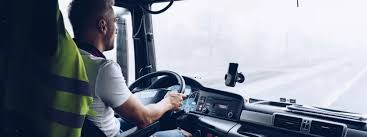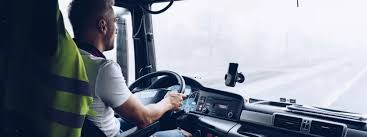
## **BUSINESS CASE**:

   The target of this project is to use a number of CNN structures to claasiy images for each class , then we use the best structure for prediction.This project is Image classification.
   
## **TASK:MULTICLASS CLASSIFICATION**


## **ABOUT DATASET**:

   The dataset contains diffrenet images of drivers behaviours consist of 5 classes which are from 2 different image formats(jpg , png) .
### **CLASSES**

**As I mentioned  before , the whole the folder contains of 5 classes which are :**
   
   

1: Other_activities : The driver is doing something except the other 4 classes which we have , this folder has 2128 images.

2: Safe_driving     : The driver is driving safely,this folder has 2203 images in itself.

3: Talking Phone    : The driver is talking on the phone , this folder has 2169 images.

4: Texting Phone    : The driver is texting on the phone , this folder has 2203 images.

5: Turning          : The driver is turning back doing something , there are 2063 images in this folder.

 ### **PROBLEM**


 This image folder contains a number of flawed images which must detect them and remove them from the list of images , that I will find them and show the address of each one and then remove them.
   


**Brief Explanation :**

   * In summary , we are going through this folder of images and load images and put them in different lists for each class , we define how many images are 
 * jps format and , how many images are png format , then I show the flawed images    , which must be deleted, next I illustrate 6 images for each 5 classes for**
    * having better understanding,after that i split images into Train , Test and Validation , consequently , I put each one in a dataset and then concat them 
 * then use ImageDataGenerator to prepare the images for out models , then use models and then shows each models in details(layers and structures) 
    * and in the end compare all models and then use the best one for prediction.








   






## **DEVICE PROJECT INTO MULTIPLE STEPS**
* Importing Libraries
* Loading Dataset
* JPG & PNG Format
* Flawed Images Cleaning
* Images Illustration
*  Training, Validation and Testing set
* Image Preprocessing
* Used ResNet50,VGG16, InceptionV3 and Xception pre-trained model
* Model Compilation
* Model Training
* Model Evaluation
* Model Saving
* Prediction on Xception model
*  Models Comparison

## **Importing libraries**

In [18]:
import numpy as np
import pandas as pd
from PIL import Image
import cv2
import os 
import random
import subprocess
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from numpy import asarray
import tensorflow as tf
from tensorflow.keras import layers, models, Input, Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow import keras
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense ,GlobalAveragePooling2D
import warnings
warnings.filterwarnings("ignore")

## **Dataset Loading**


**Description:**

* There are directory which is the address of file , folders which are 5 for each class we have , and we make 5 empty lists with the same name 
* for each class,then we load images for each class with the end of(JPG or PNG) formats with endswitch order then combine the address again for having the same address structure for each class in the lists.Before that lest see the version of Tendoeflow and after that lets see that we are using CPU or GPU.
    

In [19]:
print(f'The version of Tensorflow  is  : {tf.__version__}')

The version of Tensorflow  is  : 2.15.0


In [20]:
print('GPU is using') if len(tf.config.list_physical_devices('GPU')) == 1 else print('CPU is using')

GPU is using


In [21]:
directory = "/kaggle/input/revitsone-5class/Revitsone-5classes/"
folders = ["other_activities" , "safe_driving" , "talking_phone" , "texting_phone" , "turning"]
other_activities_img = []
safe_driving_img = []
talking_phone_img = []
texting_phone_img = []
turning_img = []
for imgother in os.listdir(directory + folders[0]):
     if imgother.endswith(".jpg") or imgother.endswith(".png"): 
            other_activities_img.append(os.path.join("/kaggle/input/revitsone-5class/Revitsone-5classes/other_activities",imgother))
            
for imgsafe in os.listdir(directory + folders[1]):
     if imgsafe.endswith(".jpg") or imgsafe.endswith(".png"): 
            safe_driving_img.append(os.path.join("/kaggle/input/revitsone-5class/Revitsone-5classes/safe_driving",imgsafe))
            
for imgtalk in os.listdir(directory + folders[2]):
     if imgtalk.endswith(".jpg") or imgtalk.endswith(".png"): 
            talking_phone_img.append(os.path.join("/kaggle/input/revitsone-5class/Revitsone-5classes/talking_phone",imgtalk))
            
for imgtext in os.listdir(directory + folders[3]):
     if imgtext.endswith(".jpg") or imgtext.endswith(".png"): 
            texting_phone_img.append(os.path.join("/kaggle/input/revitsone-5class/Revitsone-5classes/texting_phone",imgtext))
            
for imgturn in os.listdir(directory + folders[4]):
     if imgturn.endswith(".jpg") or imgturn.endswith(".png"): 
            turning_img.append(os.path.join("/kaggle/input/revitsone-5class/Revitsone-5classes/turning",imgturn))
    

**Description :**

 * Now , it is better to know exactly how many images we have for each class and how many images for each class are JPG or PNG format To do this , we creat a function to show it , by split() fuction and then a simple comparison we are able to detect them and put them in a seperated list
    

## **JPG & PNG Formats** 

In [22]:
def detect_JPG_PNG(path , name):
    JPG = []
    PNG = []
    for img in path : 
        
            if img.split('.')[1] == 'jpg':
                JPG.append(img)
            else:
                PNG.append(img)
                
    print(f'The folder name is : {name}')
    print(f'The number of all images : {len(path)}')
    print(f'The number of images with jpg format is : {len(JPG)}')
    print(f'The number of images with png format is : {len(PNG)}')



**Description :**

* We can see that the number of images with PNG format is much less then JPG format.This issue is the same for all classes**

In [23]:
detect_JPG_PNG(path = other_activities_img, name='other activities')


The folder name is : other activities

The number of all images : 2128

The number of images with jpg format is : 2068

The number of images with png format is : 60


In [24]:
detect_JPG_PNG(path = safe_driving_img, name='safe_driving')

The folder name is : safe_driving

The number of all images : 2203

The number of images with jpg format is : 2179

The number of images with png format is : 24


In [25]:
detect_JPG_PNG(path = talking_phone_img  , name = 'talking_phone')

The folder name is : talking_phone

The number of all images : 2169

The number of images with jpg format is : 2145

The number of images with png format is : 24


In [26]:
detect_JPG_PNG(path = texting_phone_img , name = 'texting')

The folder name is : texting

The number of all images : 2203

The number of images with jpg format is : 2189

The number of images with png format is : 14


In [27]:
detect_JPG_PNG(path = turning_img  , name = 'turning')

The folder name is : turning

The number of all images : 2063

The number of images with jpg format is : 2002

The number of images with png format is : 61


## **Flawed Images Cleaning**



**Description :**

* There are a number of images which have problems and must be deleted . It was really hard to detect these flawed images , the note is that all flawed images are from just two classes ,Other activities(9 flawed images) and turning(6 flawed images),The name of these images are written in a list and then showed the address and next will be removed from the list. In total we have 15 flawed images**

In [28]:
defect_images_other_activities = ['img_79.jpg' , 'img_4664.jpg' , 'img_7973.jpg' , 'img_13318.jpg' , 'img_13396.jpg' , 'img_13541.jpg' , 'img_13625.jpg' ,'img_20398.jpg' , 'img_22266.jpg']
defect_images_turning = ['img_8771.jpg' , 'img_62337.jpg' , 'img_67523.jpg' , 'img_70552.jpg','img_84605.jpg' , 'img_101434.jpg']

print(f'The number of flawed images in other activities folder is : {len(defect_images_other_activities)}')
print(f'The number of flawed images in turning folder is : {len(defect_images_turning)}')
print('--'*20)


for img in defect_images_other_activities :
    print('Images from : other_activities\n')
    remove_img = '/kaggle/input/revitsone-5class/Revitsone-5classes/other_activities/' + img
    print(f'file which has been deleted is : {remove_img}')
    other_activities_img.remove(remove_img)


print('--' * 40 )
for img in defect_images_turning :
    print('Images from : turning\n')
    remove_img = '/kaggle/input/revitsone-5class/Revitsone-5classes/turning/' + img
    print(f'file which has been deleted is : {remove_img}')
    turning_img.remove(remove_img)
     


The number of flawed images in other activities folder is : 9

The number of flawed images in turning folder is : 6

----------------------------------------

Images from : other_activities



file which has been deleted is : /kaggle/input/revitsone-5class/Revitsone-5classes/other_activities/img_79.jpg

Images from : other_activities



file which has been deleted is : /kaggle/input/revitsone-5class/Revitsone-5classes/other_activities/img_4664.jpg

Images from : other_activities



file which has been deleted is : /kaggle/input/revitsone-5class/Revitsone-5classes/other_activities/img_7973.jpg

Images from : other_activities



file which has been deleted is : /kaggle/input/revitsone-5class/Revitsone-5classes/other_activities/img_13318.jpg

Images from : other_activities



file which has been deleted is : /kaggle/input/revitsone-5class/Revitsone-5classes/other_activities/img_13396.jpg

Images from : other_activities



file which has been deleted is : /kaggle/input/revitsone-5class/Rev

## **Images illustration**


 **Description :**

 * Now , for better understanding I creat a function to show 6 images , then we apply it for each class.I also add the size of each image to realize about the height and width of the images**

In [38]:
def show_images(path , seed , kind ):
    random.seed(seed)
    Random_Image_Path = random.choices(path , k=6)
    plt.style.use('dark_background')
    plt.figure(figsize=(13 ,10))
    plt.suptitle(kind  , fontsize=15 ,fontstyle='italic' , c='black' , backgroundcolor = 'white' )
    for i, images in enumerate(Random_Image_Path):
        plt.subplot(3,2,i+1)
        img = Image.open(images)
#         plt.axis('off')
        plt.title(f'size : ({img.width} ,{img.height} )')
        plt.imshow(img)

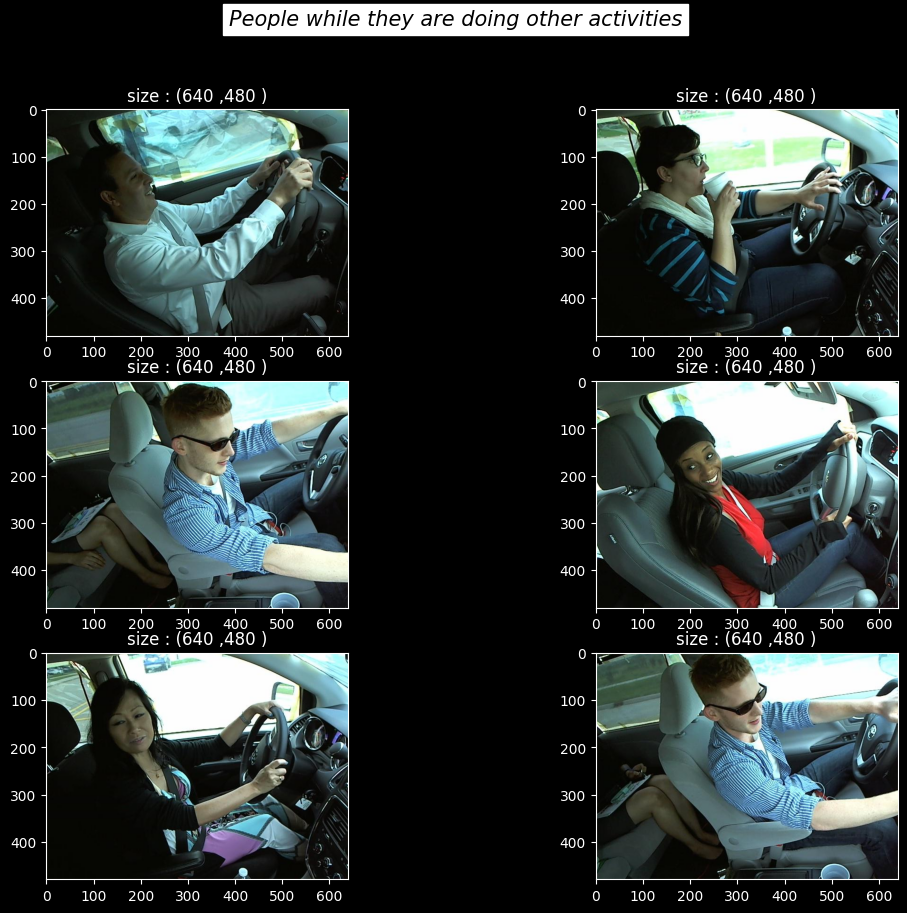

In [39]:
show_images(path = other_activities_img , seed = 42 , kind='People while they are doing other activities' )

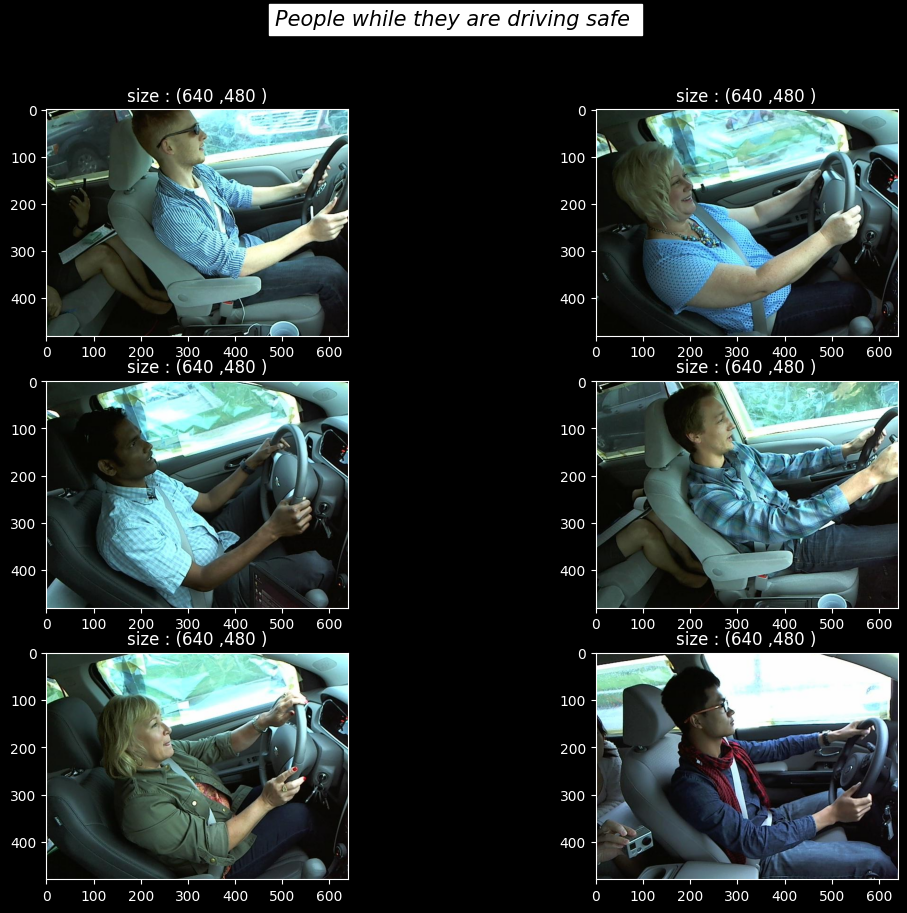

In [40]:
show_images(path = safe_driving_img , seed = 42 , kind='People while they are driving safe ' )

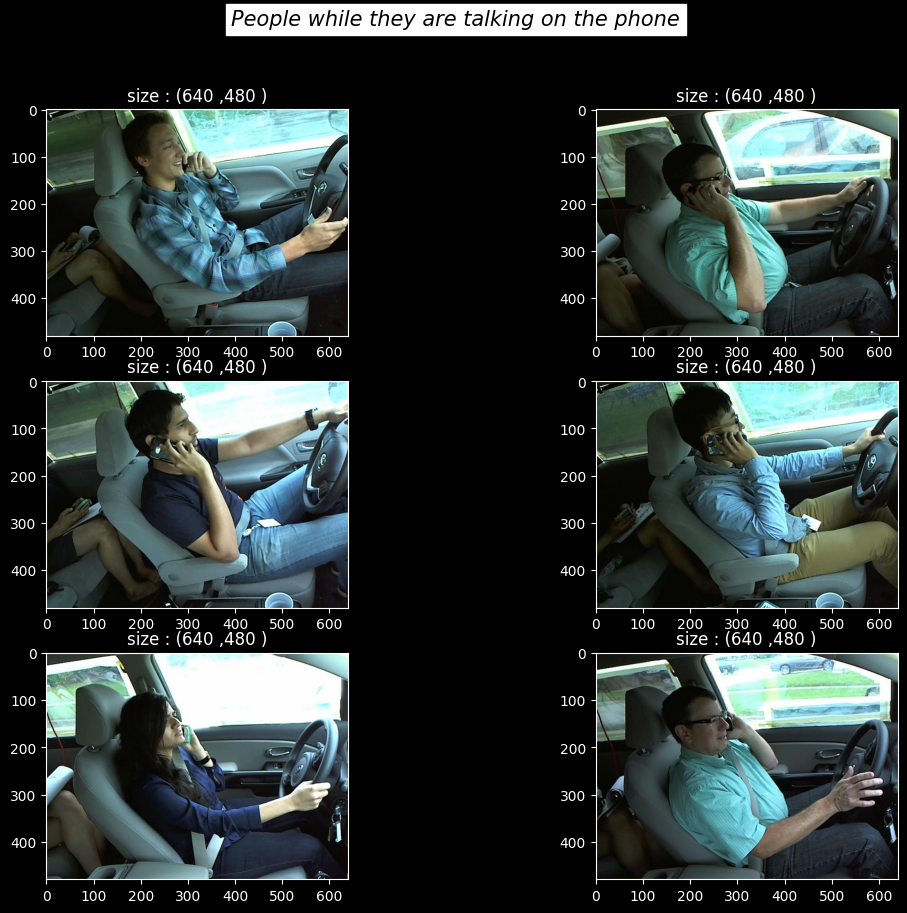

In [41]:
show_images(path = talking_phone_img , seed = 42 , kind='People while they are talking on the phone' )

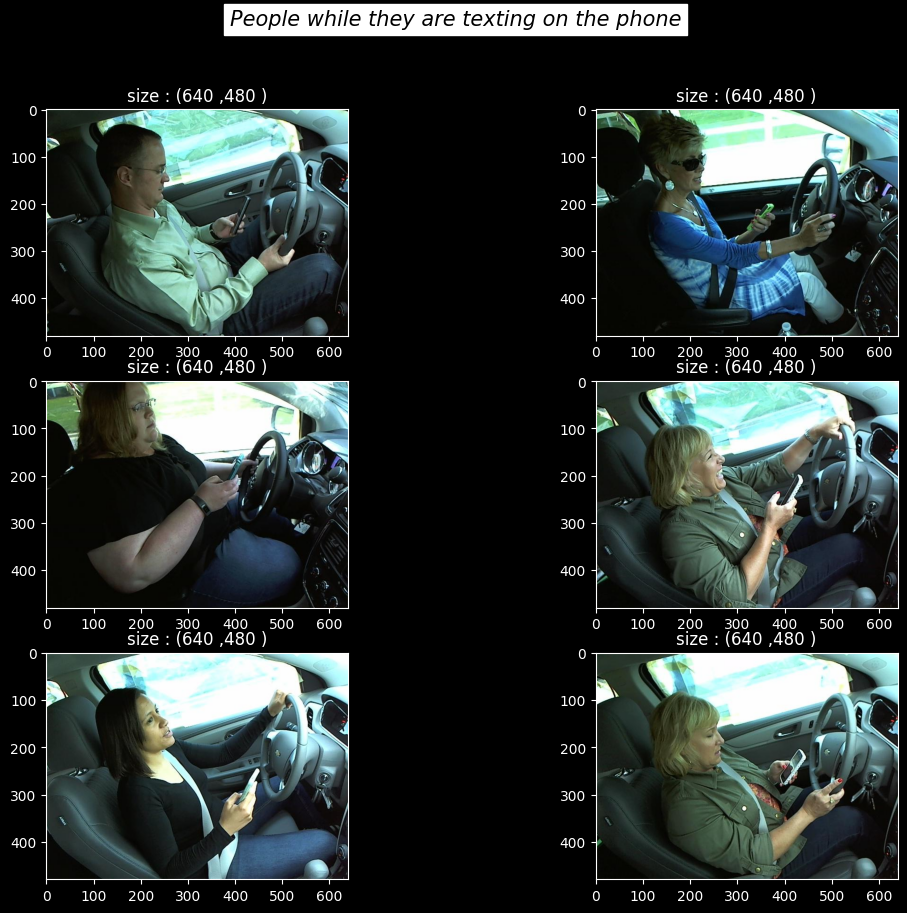

In [42]:
show_images(path = texting_phone_img , seed = 42 , kind='People while they are texting on the phone' )

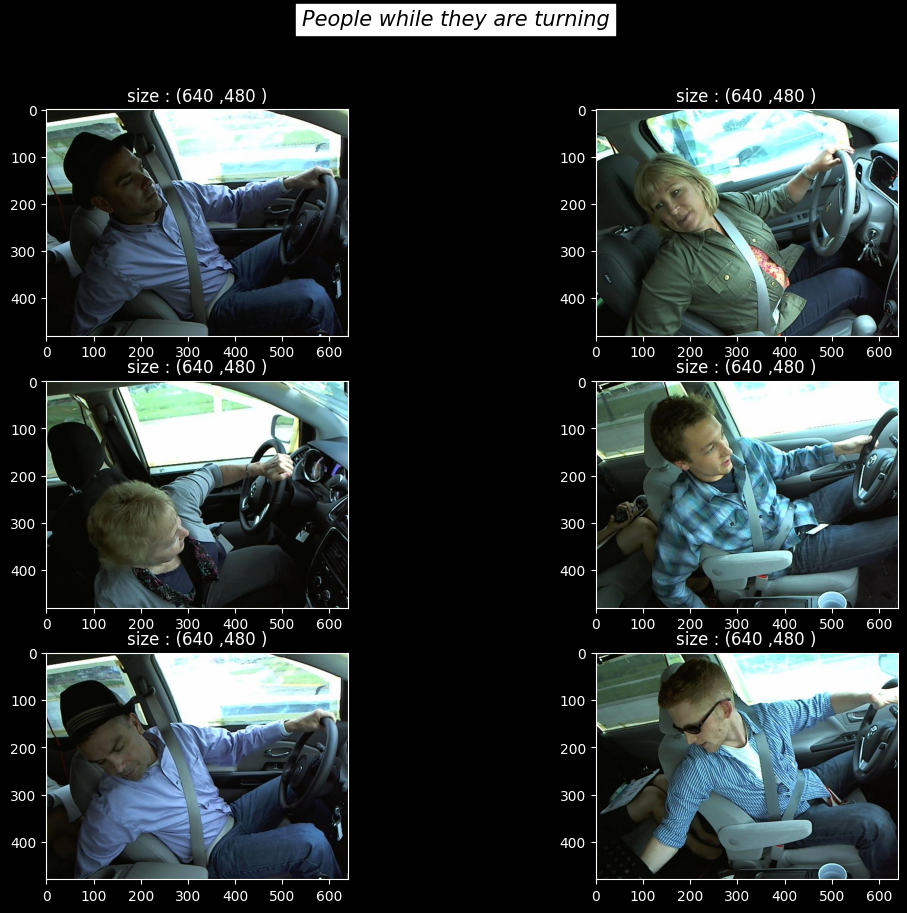

In [43]:
show_images(path = turning_img , seed = 42 , kind='People while they are turning' )

## **Train,Test & Validation**



 **Description:**

  * Here , I create Train , Test and Validation lists for each class , then a fucntion to calculate the size of Train , Test and Validation images based on the number of each class it will be splited.The note is that I put 85% for Train , 10% for Test and 5% for validation which can be changed , but the result on this seperation seems acceptable.Then, I show that how many images are exactly from this division.

In [50]:
train_other_activities  ,  test_other_activities   , valid_other_activities= [] , [] ,[]


train_drive_safe ,  test_drive_safe  , valid_drive_safe = [] , [] ,[]


train_talking  ,  test_talking   , valid_talking = [] , [] , []


train_texting  ,  test_texting   , valid_texting= [] , [] ,[]

 
train_turning  ,  test_turning   , valid_turning= [] , [] ,[]

def train_test_validation(data , Train , Test , Valid , Name ):
    
    Len = len(data)
    train_num = int( Len * 0.85)
    test_num = int(Len * 0.10)
    valid_num = int(Len * 0.05)
    
    n_t = train_num + test_num
    Train.extend(data[:train_num])
    Test.extend(data[train_num : n_t])
    Valid.extend(data[n_t :])
   

 

    print(f'Name : {Name}')
    print(f'Number of all images : {Len}')
    print(f'Train(85%) : {len(Train)}')
    print(f'Test(10%) :{len(Test)}')
    print(f'Valid(5%) : {len(Valid)}')


In [51]:
train_test_validation(data = other_activities_img , Train=train_other_activities , Test=test_other_activities , Valid=valid_other_activities , Name='Other_activities')

Name : Other_activities

Number of all images : 2119

Train(85%) : 1801

Test(10%) :211

Valid(5%) : 107


In [52]:
train_test_validation(data = safe_driving_img , Train=train_drive_safe , Test=test_drive_safe , Valid=valid_drive_safe , Name='Driving safe')

Name : Driving safe

Number of all images : 2203

Train(85%) : 1872

Test(10%) :220

Valid(5%) : 111


In [53]:
train_test_validation(data = talking_phone_img, Train=train_talking , Test=test_talking , Valid=valid_talking, Name='Talking on the phone')

Name : Talking on the phone

Number of all images : 2169

Train(85%) : 1843

Test(10%) :216

Valid(5%) : 110


In [54]:
train_test_validation(data = texting_phone_img , Train=train_texting , Test=test_texting , Valid=valid_texting , Name='Texting on the phone')

Name : Texting on the phone

Number of all images : 2203

Train(85%) : 1872

Test(10%) :220

Valid(5%) : 111


In [55]:
train_test_validation(data = turning_img , Train=train_turning , Test=test_turning , Valid=valid_turning , Name='Turning')

Name : Turning

Number of all images : 2057

Train(85%) : 1748

Test(10%) :205

Valid(5%) : 104



**Description :**
 * If we do need to use Flow_From_Dataframe() we have to convert images to dataframes to be able to load the images. To do this we create dataFrames for each Train , Test and validation for all classes and put the label for each class(2 columns we have one for image and the other for label).After doing that the only we need to do is that concat all Trains , Test and Validations together.**

In [56]:
Train_Other_DataFrame = pd.DataFrame({'Img' : train_other_activities , 'Label' : 'Other activities'})
Train_Drive_Safe_DataFrame = pd.DataFrame({'Img' : train_drive_safe , 'Label' : 'Drive safe'})
Train_Talking_DataFrame = pd.DataFrame({'Img' : train_talking , 'Label' : 'Talking'})
Train_Texting_DataFrame = pd.DataFrame({'Img' : train_texting , 'Label' : 'Texting'})
Train_Turning_DataFrame = pd.DataFrame({'Img' : train_turning , 'Label' : 'Turning'})

#--------------------------------------------------------Train DF

Test_Other_DataFrame = pd.DataFrame({'Img' : test_other_activities , 'Label' : 'Other activities'})
Test_Drive_Safe_DataFrame = pd.DataFrame({'Img' : test_drive_safe , 'Label' : 'Drive safe'})
Test_Talking_DataFrame = pd.DataFrame({'Img' : test_talking , 'Label' : 'Talking'})
Test_Texting_DataFrame = pd.DataFrame({'Img' : test_texting , 'Label' : 'Texting'})
Test_Turning_DataFrame = pd.DataFrame({'Img' : test_turning ,  'Label' : 'Turning'})

#---------------------------------------------------------Test DF

Valid_Other_DataFrame = pd.DataFrame({'Img' : valid_other_activities , 'Label' : 'Other activities'})
Valid_Drive_Safe_DataFrame = pd.DataFrame({'Img' : valid_drive_safe , 'Label' : 'Drive safe'})
Valid_Talking_DataFrame = pd.DataFrame({'Img' : valid_talking , 'Label' : 'Talking'})
Valid_Texting_DataFrame = pd.DataFrame({'Img' : valid_texting , 'Label' : 'Texting'})
Valid_Turning_DataFrame = pd.DataFrame({'Img' : valid_turning , 'Label' : 'Turning'})

#-----------------------------------------------------------Valid DF

In [57]:
Train_df_all = pd.concat([Train_Other_DataFrame , Train_Drive_Safe_DataFrame , Train_Talking_DataFrame , Train_Texting_DataFrame , Train_Turning_DataFrame])
Test_df_all = pd.concat([Test_Other_DataFrame , Test_Drive_Safe_DataFrame , Test_Talking_DataFrame , Test_Texting_DataFrame , Test_Turning_DataFrame])
Valid_df_all = pd.concat([Valid_Other_DataFrame , Valid_Drive_Safe_DataFrame , Valid_Talking_DataFrame , Valid_Texting_DataFrame , Valid_Turning_DataFrame])

In [58]:
print(f'The shape of Train DataFrame is : {Train_df_all.shape}')
print(f'The shape of Test DataFrame is : {Test_df_all.shape}')
print(f'The shape of Valid DataFrame is : {Valid_df_all.shape}')

The shape of Train DataFrame is : (9136, 2)

The shape of Test DataFrame is : (1072, 2)

The shape of Valid DataFrame is : (543, 2)


In [59]:
Driver_behaviour_classes = ['Drive safe' , 'Other activities' ,   'Talking' , 'Texting' ,'Turning']

In [60]:
Driver_behaviour_classes

['Drive safe', 'Other activities', 'Talking', 'Texting', 'Turning']

In [61]:
Train_df_all

,Img,Label
0,/kaggle/input/revitsone-5class/Revitsone-5clas...,Other activities
1,/kaggle/input/revitsone-5class/Revitsone-5clas...,Other activities
2,/kaggle/input/revitsone-5class/Revitsone-5clas...,Other activities
3,/kaggle/input/revitsone-5class/Revitsone-5clas...,Other activities
4,/kaggle/input/revitsone-5class/Revitsone-5clas...,Other activities
...,...,...
1743,/kaggle/input/revitsone-5class/Revitsone-5clas...,Turning
1744,/kaggle/input/revitsone-5class/Revitsone-5clas...,Turning
1745,/kaggle/input/revitsone-5class/Revitsone-5clas...,Turning
1746,/kaggle/input/revitsone-5class/Revitsone-5clas...,Turning


## **Image Preprocessing**


**Description :**

  * We need to do some transformation to prepare our images for our models .the most important one is rescale the images.rescale=1./255 divides each pixel value by 255.It means that we brings them between 0-1 .We can also do some other things(Augmentation) but here I didnt get a good result (you can also do it if you like).

In [62]:
Train_Image_Data_Generator = ImageDataGenerator(rescale=1./255.)
Test_Image_Data_Generator = ImageDataGenerator(rescale=1./255.)
Valid_Image_Data_Generator = ImageDataGenerator(rescale=1./255.)


**Description :**

 * A number of hyper parameters we have to define for out model , we can also write when we define them.Num_classes is the number of classes that we have , batch_size is the number of images that we give to our model each time(note: this value is important , if the size is less than it should be the time of each epoch will raise , if too much the GPU or CPU of your system can not handle it , this valud is based on the power of your processing system, if you have a powerful one you can increase the number(32-64-128) the common bach size that I see. image size is the transformation of the size of image from (640-480) to this size)**

In [63]:
num_classes = 5 
bach_size = 64
img_size = 240 


**Description :**

   * Now for each Train , Test and Validation , we use flow_from_dataframe and pass those dataframes which we have already created to prepare them for our model.There are a number of hyperparameters which must be defined , dataframe = which the name of dataframe(for each train , test , validation must define seperately) then class_mode = that here due to we have 5 classes we should put categorical , X_col and Y_col that X is the images and Y is the label in our dataframe , batch_size = we have talked about it and defined it before , seed=42 or any other number for having the same result in running the code , shuffle = True this parameter is important to be True due to the fact that images must blend before they pass to the dataloader and baches because it is probable that some images with the same features or problems or photo aspecst are next to each other and when this hyperparameter is not True all images next to each other in a row pass but when it is True they blen firstly and then pass.Target size we have talked about it before.Note: we do not need to do the shuffle for test images But we can still put it as True**

In [64]:
Train_loader = Train_Image_Data_Generator.flow_from_dataframe(
    dataframe=Train_df_all , 
    class_mode='categorical' , 
    x_col='Img' , 
    y_col='Label',
    batch_size=bach_size ,
    seed=42 , 
    shuffle=True , 
    target_size =(img_size , img_size)
)


Test_loader =Test_Image_Data_Generator.flow_from_dataframe(
    dataframe=Test_df_all , 
    class_mode='categorical' , 
    x_col='Img' , 
    y_col='Label',
    batch_size=bach_size ,
    seed=42 , 
    shuffle=True , #also can be False , No difference in result 
    target_size =(img_size , img_size)
)



Valid_loader =Valid_Image_Data_Generator.flow_from_dataframe(
    dataframe=Valid_df_all , 
    class_mode='categorical' , 
    x_col='Img' , 
    y_col='Label',
    batch_size=bach_size ,
    seed=42 , 
    shuffle=True , 
    target_size =(img_size , img_size)
)

Found 9136 validated image filenames belonging to 5 classes.

Found 1072 validated image filenames belonging to 5 classes.

Found 543 validated image filenames belonging to 5 classes.




**Description :**

 **I want to create two functions for showing the result of our model (accuracy and loss)**

In [72]:
def show_accuracy(Train_acc , Val_acc , epoch_num , model):
    plt.style.use('dark_background')
    plt.figure(figsize=(10 , 5))
    plt.plot(epoch_num, Train_acc, '--bo', color= 'white')
    plt.plot(epoch_num, Val_acc, '--bo',color= 'blue', linewidth = '2.5', label='line with marker')
    plt.legend(['Training Acc', 'Val Acc'])
    plt.title(f'Train & Val Accuracy in {model}')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.xticks(np.arange(1,7,1))
    plt.show()
    
def show_loss(Train_loss , Val_loss , epoch_num , model):
    plt.style.use('dark_background')
    plt.figure(figsize=(10 , 5))
    plt.plot(epoch_num, Train_loss, '--bo',linewidth = '1.5', color= 'white')
    plt.plot(epoch_num, Val_loss, '--bo',color= 'blue', linewidth = '1.5', label='line with marker')
    plt.legend(['Training Loss', 'Val Loss'])
    plt.title(f'Train & Val Loss in {model}')
    plt.xlabel('Epoch' , c='b')
    plt.ylabel('Accuracy', c='b')
    plt.xticks(np.arange(1,7,1))
    plt.show()



**Description :**

**Before going through CNN models I just want to indicate that I just define a couple of hyperparameters the same for all 4 models , such as Number of epochs(6) , learning rate(0.001), and the Optimizer(BinaryCrossEntropy)**


<center>
<img src="https://www.researchgate.net/publication/348756587/figure/tbl1/AS:984065545089024@1611630917849/The-depth-and-parameters-of-pre-trained-models.png" width=700 height=400 />
</center>

## **VGG16**

<center>
<img src="https://miro.medium.com/v2/resize:fit:1400/1*ZqkQYVB3_Gw0hjrAMzi6_A.png" width=700 height=400 />
</center>

In [66]:
VGG = keras.applications.vgg16.VGG16(include_top=False , weights='imagenet')
x=VGG.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024 , activation='relu')(x)
prediction = Dense(5 , activation='softmax')(x)
Model_VGG16 = Model(inputs = VGG.inputs , outputs =prediction)
Model_VGG16.summary()


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, None, None, 3)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, None, None, 64) │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, None, None, 64) │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, None, None, 64) │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, None, None,     │        73,856 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, None, None,     │       147,584 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, None, None,     │       295,168 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, None, None,     │       590,080 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, None, None,     │       590,080 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, None, None,     │     1,180,160 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │             

 Total params: 15,245,125 (58.16 MB)

 Trainable params: 15,245,125 (58.16 MB)

 Non-trainable params: 0 (0.00 B)


* **[Description :what is VGG16?](#1)**

**For cleaner understanding the layers we can use utils.plot_model to visually observe the layer of any of our CNN models.**

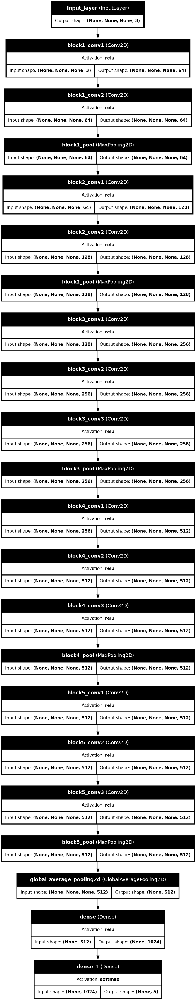

In [81]:
tf.keras.utils.plot_model(
    Model_VGG16,
    to_file='vgg_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=80
)

## **COMPILE AND TRAIN MODEL**

In [70]:
Model_VGG16.compile(loss=BinaryCrossentropy(),
              optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

In [73]:
VGG16_model = Model_VGG16.fit(Train_loader, epochs=6, validation_data=Valid_loader)

Epoch 1/6


2024-06-09 06:13:01.593177: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng15{k5=1,k6=0,k7=1,k10=1} for conv (f32[64,64,240,240]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,3,240,240]{3,2,1,0}, f32[64,3,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...

2024-06-09 06:13:02.232931: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57600: 4.29837, expected 3.76536

2024-06-09 06:13:02.232989: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57653: 3.75336, expected 3.22035

2024-06-09 06:13:02.233000: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57654: 4.07898, expected 3.54597

2024-06-09 06:13:02.233008: E external/local_xla/xla/service/gpu/buffer_compa

 89/143 ━━━━━━━━━━━━━━━━━━━━ 33s 627ms/step - accuracy: 0.2033 - loss: 0.7947

2024-06-09 06:15:13.592401: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng15{k5=1,k6=0,k7=1,k10=1} for conv (f32[48,64,240,240]{3,2,1,0}, u8[0]{0}) custom-call(f32[48,3,240,240]{3,2,1,0}, f32[64,3,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kRelu","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...

2024-06-09 06:15:13.873751: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57600: 3.41287, expected 2.85034

2024-06-09 06:15:13.873800: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57613: 4.58477, expected 4.02224

2024-06-09 06:15:13.873810: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57628: 4.36408, expected 3.80155

2024-06-09 06:15:13.873819: E external/local_xla/xla/service/gpu/buffer_compa

143/143 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.2014 - loss: 0.7075

2024-06-09 06:16:48.490846: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57600: 3.94968, expected 3.38645

2024-06-09 06:16:48.490902: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57613: 4.02395, expected 3.46073

2024-06-09 06:16:48.490911: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57627: 4.41065, expected 3.84742

2024-06-09 06:16:48.490922: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57648: 3.74156, expected 3.17833

2024-06-09 06:16:48.490930: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57649: 4.29365, expected 3.73042

2024-06-09 06:16:48.490939: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57653: 3.27829, expected 2.71506

2024-06-09 06:16:48.490947: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 57654: 2.98417, expected 2.42094

2024-06-09 06:16:48.

143/143 ━━━━━━━━━━━━━━━━━━━━ 253s 1s/step - accuracy: 0.2014 - loss: 0.7064 - val_accuracy: 0.1971 - val_loss: 0.5041

Epoch 2/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 64s 435ms/step - accuracy: 0.2006 - loss: 0.5016 - val_accuracy: 0.2707 - val_loss: 0.4888

Epoch 3/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 64s 435ms/step - accuracy: 0.3423 - loss: 0.4537 - val_accuracy: 0.3959 - val_loss: 0.3992

Epoch 4/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 64s 435ms/step - accuracy: 0.5005 - loss: 0.3649 - val_accuracy: 0.6280 - val_loss: 0.3043

Epoch 5/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 64s 435ms/step - accuracy: 0.6396 - loss: 0.2973 - val_accuracy: 0.7311 - val_loss: 0.2383

Epoch 6/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 64s 436ms/step - accuracy: 0.7820 - loss: 0.2006 - val_accuracy: 0.8766 - val_loss: 0.1399


In [53]:
# tf.config.run_functions_eagerly(True)


**Description :**

**Let's see the result(accuracy and loss for both Train and Validation) visually for each epoch ...**

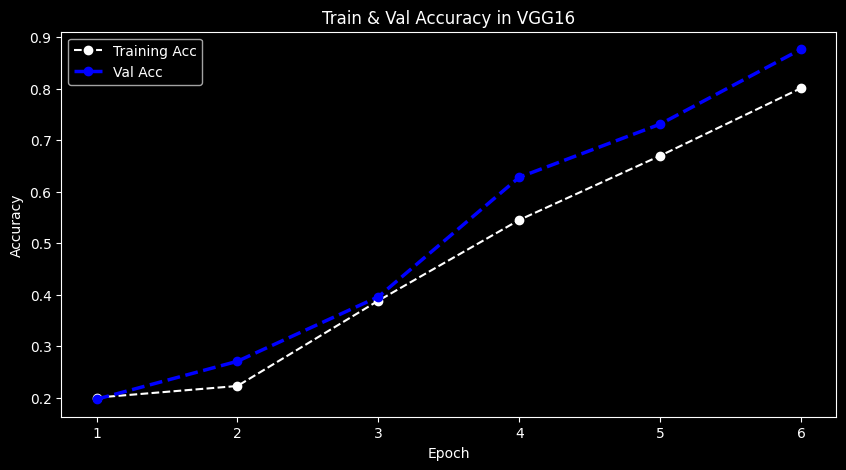

In [74]:
show_accuracy(Train_acc=VGG16_model.history['accuracy'] , Val_acc=VGG16_model.history['val_accuracy'] , epoch_num= range(1,7,1) , model='VGG16')

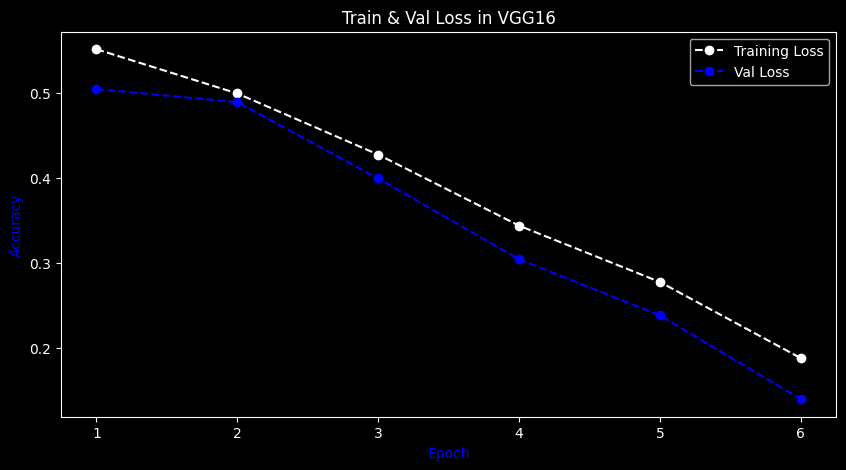

In [78]:
show_loss(Train_loss=VGG16_model.history['loss'] , Val_loss=VGG16_model.history['val_loss'] , epoch_num=range(1,7,1) , model='VGG16')

In [79]:
Model_VGG16.evaluate(Test_loader)#Evaluate the model 


17/17 ━━━━━━━━━━━━━━━━━━━━ 11s 655ms/step - accuracy: 0.8615 - loss: 0.1694


[0.1448066085577011, 0.878731369972229]

In [80]:
Model_VGG16.save('VGG16.h5')#saving the Xception model

## **ResNet50**

<center>
<img src="https://miro.medium.com/v2/resize:fit:1400/0*tH9evuOFqk8F41FG.png" width=700 height=400 />
</center>

In [82]:
Resnet50 = keras.applications.resnet50.ResNet50(include_top=False , weights='imagenet')
X=Resnet50.output
X=GlobalAveragePooling2D()(X)
X=Dense(1024 , activation='relu')(X)
Xprediction = Dense(5 , activation='softmax')(X)
Model_Resnet50 = Model(inputs = Resnet50.inputs , outputs = Xprediction)
Model_Resnet50.summary()


94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, None,      │          0 │ input_layer_1[0]… │
│ (ZeroPadding2D)     │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, None,      │      9,472 │ conv1_pad[0][0]   │
│                     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, None,      │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, None,      │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, None,      │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, None,      │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, None,      │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, None,      │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, None,      │          0 │ conv2_block1_1_b… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, None,      │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, None,      │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, None,      │          0 │ conv2_block1_2_b… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, None,      │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ None, 256)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, None,      │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ None, 256)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, None,      │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ None, 256)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, None,      │      1,024 │ conv2_block1_3_c

 Total params: 25,691,013 (98.00 MB)

 Trainable params: 25,637,893 (97.80 MB)

 Non-trainable params: 53,120 (207.50 KB)

In [83]:
tf.keras.utils.plot_model(
    Model_Resnet50,
    to_file='ResNet50_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=80
)

## **COMPILE AND TRAIN MODEL**

In [84]:
Model_Resnet50.compile(loss=BinaryCrossentropy(),
            optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])


In [85]:
Res50_model =  Model_Resnet50.fit(Train_loader, epochs=6, validation_data=Valid_loader)

Epoch 1/6


2024-06-09 06:32:36.391035: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[64,1024,15,15]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,2048,8,8]{3,2,1,0}, f32[2048,1024,1,1]{3,2,1,0}), window={size=1x1 stride=2x2}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...

2024-06-09 06:32:36.522004: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.1311457s

Trying algorithm eng0{} for conv (f32[64,1024,15,15]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,2048,8,8]{3,2,1,0}, f32[2048,1024,1,1]{3,2,1,0}), window={size=1x1 stride=2x2}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...

2024-06-09 06:32:37.550656: E external

143/143 ━━━━━━━━━━━━━━━━━━━━ 176s 675ms/step - accuracy: 0.7807 - loss: 0.2381 - val_accuracy: 0.2044 - val_loss: 23.0866

Epoch 2/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 49s 326ms/step - accuracy: 0.9660 - loss: 0.0365 - val_accuracy: 0.1971 - val_loss: 0.5283

Epoch 3/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 49s 327ms/step - accuracy: 0.9798 - loss: 0.0236 - val_accuracy: 0.2044 - val_loss: 3.7248

Epoch 4/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 49s 326ms/step - accuracy: 0.9783 - loss: 0.0232 - val_accuracy: 0.1915 - val_loss: 0.9705

Epoch 5/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 49s 327ms/step - accuracy: 0.9859 - loss: 0.0161 - val_accuracy: 0.1971 - val_loss: 0.8339

Epoch 6/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 49s 328ms/step - accuracy: 0.9829 - loss: 0.0164 - val_accuracy: 0.3738 - val_loss: 0.7619




**Description :**

**Lets see the result of ResNet in both Accuracy and Loss in Train and Validation**

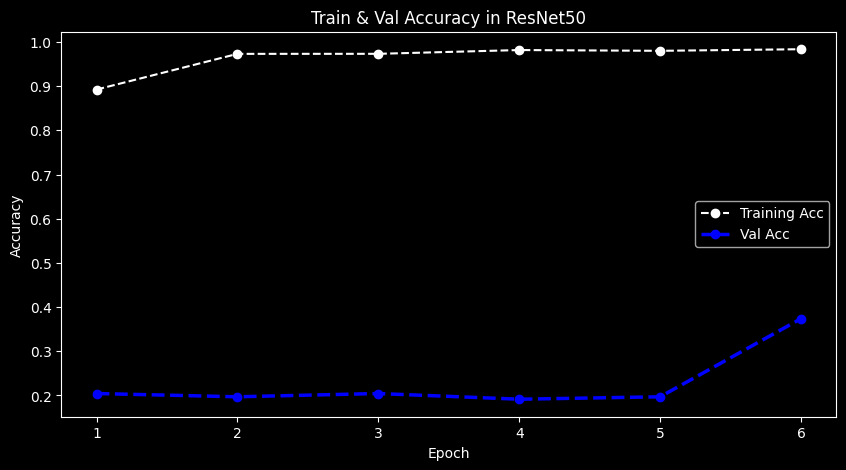

In [86]:
show_accuracy(Train_acc=Res50_model.history['accuracy'] , Val_acc=Res50_model.history['val_accuracy'] , epoch_num= range(1,7,1) , model='ResNet50')


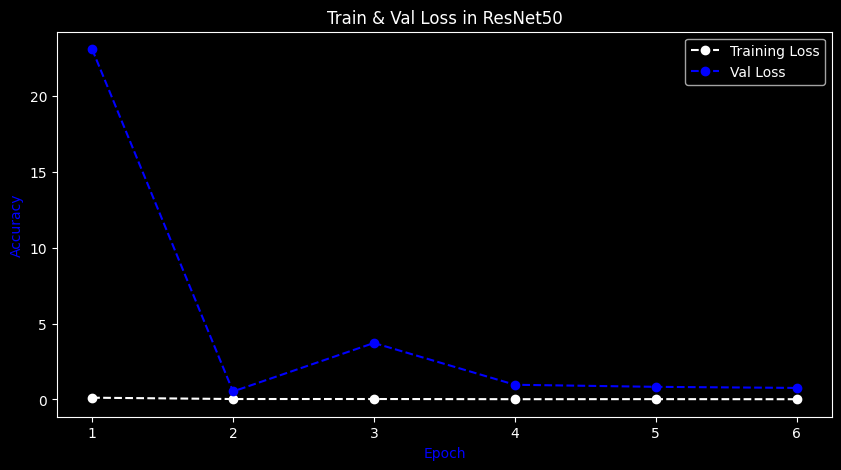

In [87]:
show_loss(Train_loss=Res50_model.history['loss'] , Val_loss=Res50_model.history['val_loss'] , epoch_num=range(1,7,1) , model='ResNet50')


**Description :**

**We can see that our ResNet50 model shows high overfit on the validation and all epochs Train chart is great 98% accuracy but validation at maximum 37% accuracy which doesnt acceptable.I also put the model for learning for more epochs and this problem seem the same for even higher epochs.We skip from this model but however we check the elavuation and save in case it needs.Accuracy is much less even than VGG16 , which this model with more layers and more complexity is not good for our task.**

In [88]:
Model_Resnet50.evaluate(Test_loader)#Evaluate the model 

17/17 ━━━━━━━━━━━━━━━━━━━━ 7s 391ms/step - accuracy: 0.3617 - loss: 0.7796


[0.7820088267326355, 0.35634326934814453]

In [89]:
Model_Resnet50.save('ResNet50.h5')#saving the Xception model

## **Inceptionv3**

<center>
<img src="https://miro.medium.com/v2/resize:fit:1200/1*5Oj_rquiiX0Y-Frntj5t8A.jpeg" width=700 height=400 />
</center>

In [90]:
Inceptionv3 = keras.applications.inception_v3.InceptionV3(include_top=False , weights='imagenet')
X = Inceptionv3.output
X = GlobalAveragePooling2D()(X)
X= Dense(1024 , activation='relu')(X)
prediction= Dense(5 , activation='softmax')(X)
Model_Inceptionv3 = Model(inputs = Inceptionv3.inputs , outputs = prediction )
Model_Inceptionv3.summary()


87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, None,      │        864 │ input_layer_2[0]… │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, None,      │         96 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, None,      │      9,216 │ activation[0][0]  │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │         96 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, None,      │     18,432 │ activation_1[0][… │
│                     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        192 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, None,      │          0 │ activation_2[0][… │
│ (MaxPooling2D)      │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, None,      │      5,120 │ max_pooling2d[0]… │
│                     │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        240 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, None,      │    138,240 │ activation_3[0][… │
│                     │ None, 192)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        576 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ None, 192)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, None,      │          0 │ batch_normalizat

 Total params: 23,906,085 (91.19 MB)

 Trainable params: 23,871,653 (91.06 MB)

 Non-trainable params: 34,432 (134.50 KB)

In [91]:
tf.keras.utils.plot_model(
    Model_Inceptionv3,
    to_file='Inceptionv3_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=80
)

## **COMPILE AND TRAIN MODEL**

In [93]:
Model_Inceptionv3.compile(loss=BinaryCrossentropy(),
            optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

In [94]:
IncV3_model = Model_Inceptionv3.fit(Train_loader, epochs=6, validation_data=Valid_loader)

Epoch 1/6


2024-06-09 06:49:18.062340: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[192,80,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,80,58,58]{3,2,1,0}, f32[64,192,56,56]{3,2,1,0}), window={size=3x3}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...

2024-06-09 06:49:18.128088: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.065929974s

Trying algorithm eng0{} for conv (f32[192,80,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,80,58,58]{3,2,1,0}, f32[64,192,56,56]{3,2,1,0}), window={size=3x3}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...

2024-06-09 06:49:19.581939: E external/local_xla/xla/service/slo

143/143 ━━━━━━━━━━━━━━━━━━━━ 209s 780ms/step - accuracy: 0.7886 - loss: 0.2208 - val_accuracy: 0.6133 - val_loss: 0.6584

Epoch 2/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 288ms/step - accuracy: 0.9696 - loss: 0.0320 - val_accuracy: 0.9429 - val_loss: 0.0831

Epoch 3/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 288ms/step - accuracy: 0.9783 - loss: 0.0255 - val_accuracy: 0.7698 - val_loss: 0.3653

Epoch 4/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 289ms/step - accuracy: 0.9710 - loss: 0.0308 - val_accuracy: 0.8232 - val_loss: 0.2975

Epoch 5/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 289ms/step - accuracy: 0.9836 - loss: 0.0136 - val_accuracy: 0.9890 - val_loss: 0.0124

Epoch 6/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 290ms/step - accuracy: 0.9780 - loss: 0.0192 - val_accuracy: 0.9797 - val_loss: 0.0299




**Description :**

**Lets see the result for our model...**

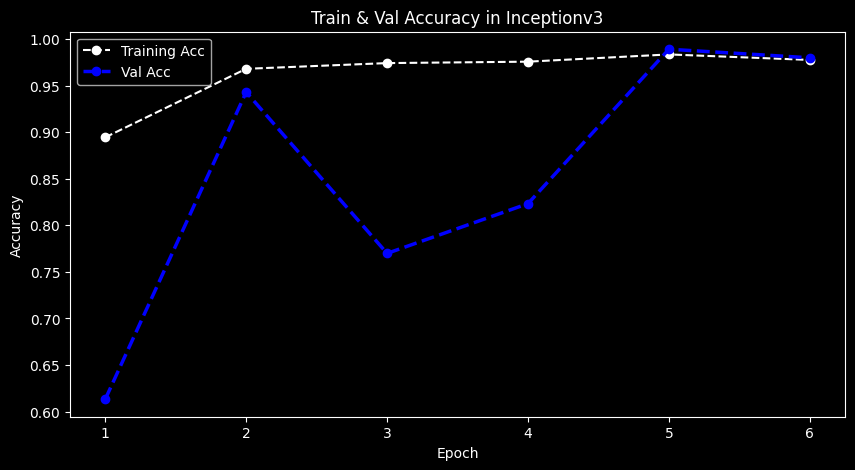

In [96]:

show_accuracy(Train_acc=IncV3_model.history['accuracy'] , Val_acc=IncV3_model.history['val_accuracy'] , epoch_num= range(1,7,1) , model='Inceptionv3')

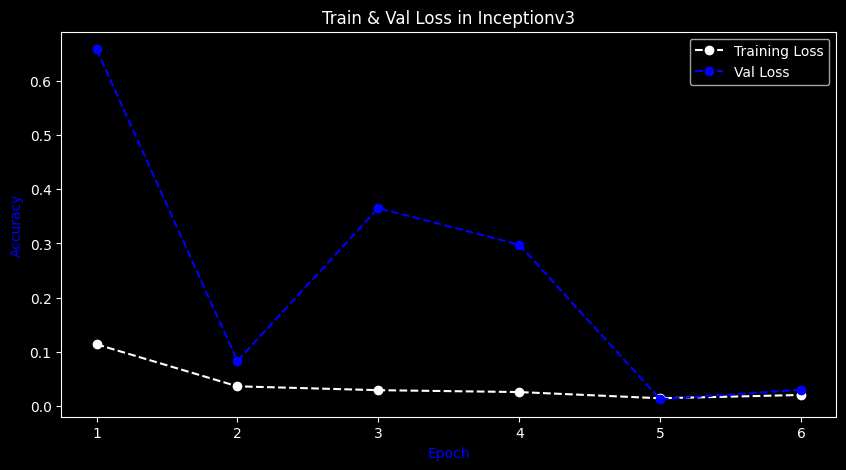

In [97]:


show_loss(Train_loss=IncV3_model.history['loss'] , Val_loss=IncV3_model.history['val_loss'] , epoch_num=range(1,7,1) , model='Inceptionv3')



**Description :**

**we can see that the Inceptionv3 model got started with a good accuracy , in the epoch 2 we can see that validation acc gets 94 % but in the next epochs decreased , however in the final epochs showed acceptable result and more that Train acc , in total this model shows a great Acc for both , even we could have used Callbacks for Stop Learning and Save model with higher accuracy in the 5th epoch , but see the final Xception model , before that lets again evaluate and save the model.96% accuracy and very little loss...**

In [98]:
Model_Inceptionv3.evaluate(Test_loader)#Evaluate the model 

17/17 ━━━━━━━━━━━━━━━━━━━━ 8s 475ms/step - accuracy: 0.9651 - loss: 0.0337


[0.03943809121847153, 0.9654850959777832]

In [99]:
Model_Inceptionv3.save('Inceptionv3.h5')#saving the Xception model

## **Xception**

<center>
<img src="https://stephan-osterburg.gitbook.io/~gitbook/image?url=https%3A%2F%2F4138123170-files.gitbook.io%2F%7E%2Ffiles%2Fv0%2Fb%2Fgitbook-legacy-files%2Fo%2Fassets%252F-LRrOFNeUGLZef_2NLZ0%252F-LeEDJgZ_Xj2uTEbaYKT%252F-LeEHZndr-UWea8jfQP8%252Fxception1.jpg%3Falt%3Dmedia%26token%3Dd2a19b1a-1b5b-410d-90a5-7a5a993fe026&width=768&dpr=4&quality=100&sign=8e4eb806199c59f25169ee2e5f9875634e44f1cc87c57fef621cc6576f25ec7c" width=700 height=400 />
</center>

In [100]:
Xception = keras.applications.xception.Xception(include_top=False , weights='imagenet')
x=Xception.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024 , activation='relu')(x)
Xception_prediction = Dense(5 , activation='softmax')(x)
Model_Xception = Model(inputs = Xception.inputs , outputs =Xception_prediction)
Model_Xception.summary()


83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


Model: "functional_7"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1        │ (None, None,      │        864 │ input_layer_3[0]… │
│ (Conv2D)            │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_bn     │ (None, None,      │        128 │ block1_conv1[0][… │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_act    │ (None, None,      │          0 │ block1_conv1_bn[… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2        │ (None, None,      │     18,432 │ block1_conv1_act… │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_bn     │ (None, None,      │        256 │ block1_conv2[0][… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_act    │ (None, None,      │          0 │ block1_conv2_bn[… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1     │ (None, None,      │      8,768 │ block1_conv2_act… │
│ (SeparableConv2D)   │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1_bn  │ (None, None,      │        512 │ block2_sepconv1[… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_act │ (None, None,      │          0 │ block2_sepconv1_… │
│ (Activation)        │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2     │ (None, None,      │     17,536 │ block2_sepconv2_… │
│ (SeparableConv2D)   │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_bn  │ (None, None,      │        512 │ block2_sepconv2[… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_94 (Conv2D)  │ (None, None,      │      8,192 │ block1_conv2_act… │
│                     │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_pool         │ (None, None,      │          0 │ block2_sepconv2_… │
│ (MaxPooling2D)      │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        512 │ conv2d_94[0][0]   │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, None,      │          0 │ block2_pool[0][0… │
│                     │ None, 128)        │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block3_sepconv1_act │ (None, None,      │          0 │ add[0][0]       

 Total params: 22,964,781 (87.60 MB)

 Trainable params: 22,910,253 (87.40 MB)

 Non-trainable params: 54,528 (213.00 KB)

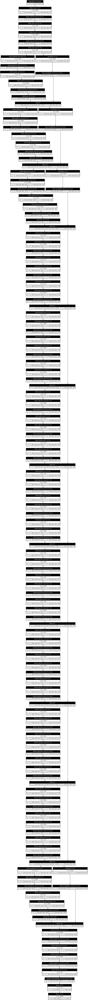

In [101]:
tf.keras.utils.plot_model(
    Model_Xception,
    to_file='Xception_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=80
)

## **COMPILE AND TRAIN MODEL**

In [102]:
Model_Xception.compile(loss=BinaryCrossentropy(),
            optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

In [103]:
X_model = Model_Xception.fit(Train_loader, epochs=6, validation_data=Valid_loader)

Epoch 1/6


2024-06-09 07:03:21.553191: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[728,728,1,1]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,728,30,30]{3,2,1,0}, f32[64,728,30,30]{3,2,1,0}), window={size=1x1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...

2024-06-09 07:03:21.722683: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.169602076s

Trying algorithm eng0{} for conv (f32[728,728,1,1]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,728,30,30]{3,2,1,0}, f32[64,728,30,30]{3,2,1,0}), window={size=1x1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...

2024-06-09 07:03:23.316104: E external/local_xla/xla/service

143/143 ━━━━━━━━━━━━━━━━━━━━ 230s 1s/step - accuracy: 0.6637 - loss: 0.2885 - val_accuracy: 0.9153 - val_loss: 0.1607

Epoch 2/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 84s 573ms/step - accuracy: 0.9713 - loss: 0.0322 - val_accuracy: 0.7366 - val_loss: 0.7097

Epoch 3/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 142s 574ms/step - accuracy: 0.9787 - loss: 0.0231 - val_accuracy: 0.9779 - val_loss: 0.0177

Epoch 4/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 84s 574ms/step - accuracy: 0.9826 - loss: 0.0201 - val_accuracy: 0.9319 - val_loss: 0.1101

Epoch 5/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 84s 574ms/step - accuracy: 0.9837 - loss: 0.0145 - val_accuracy: 0.9429 - val_loss: 0.0522

Epoch 6/6

143/143 ━━━━━━━━━━━━━━━━━━━━ 84s 572ms/step - accuracy: 0.9897 - loss: 0.0110 - val_accuracy: 0.9871 - val_loss: 0.0117


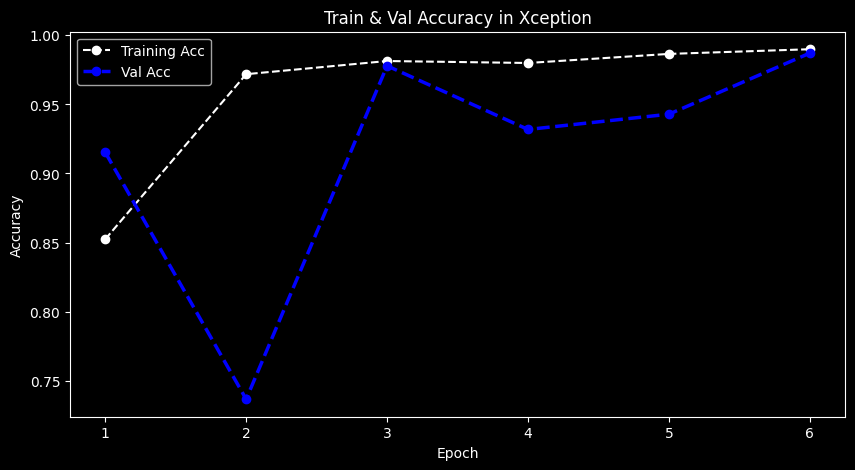

In [104]:
show_accuracy(Train_acc=X_model.history['accuracy'] , Val_acc=X_model.history['val_accuracy'] , epoch_num= range(1,7,1) , model='Xception')


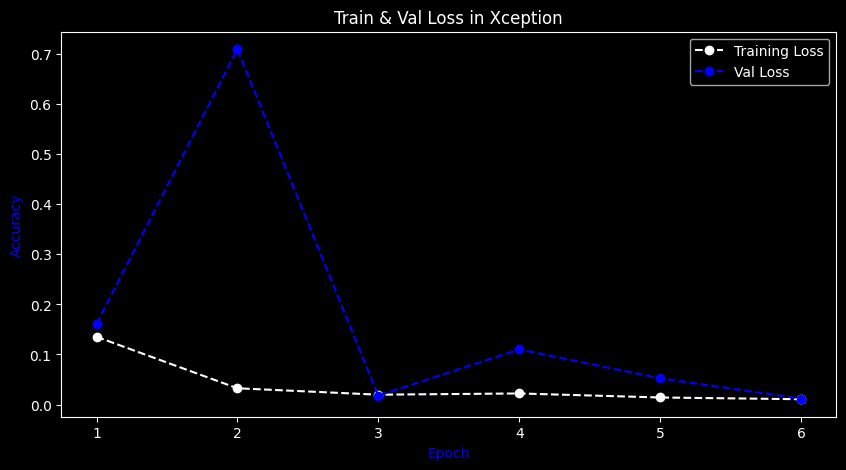

In [105]:
show_loss(Train_loss=X_model.history['loss'] , Val_loss=X_model.history['val_loss'] , epoch_num=range(1,7,1) , model='Xception')



**Description :**

**First epoch , shows overfited on the Train but by chance great on the validation with about 91% accuracy , Next epoch shows logical fall for Validation and increase for Train , the 3rd epoch Train and Validation got to each other , and decrease occurred for Val again but in the end Valid and Train Both with an acceptable result got to each other , we could also led to learn for more epochs but at most 0.05 % gets better on Validation (I trained it even for 10 epochs).Lets evaluate and save the model  and show you how to load the saved models in case usage.99% accuracy , great result.tf.keras.models.load_model('XceptionModel.h5') by this code and address in the load_model() function you are able to load the saved model easily.**

In [106]:
Model_Xception.evaluate(Test_loader)#Evaluate the model 

17/17 ━━━━━━━━━━━━━━━━━━━━ 6s 370ms/step - accuracy: 0.9916 - loss: 0.0124


[0.015236432664096355, 0.9906716346740723]

In [107]:
Model_Xception.save('XceptionModel.h5')#saving the Xception model


In [108]:
tf.keras.models.load_model('XceptionModel.h5')# Loading Xception model from the address we have already saved that 

<Functional name=functional_7, built=True>

## **Models Comparison**



**Description :**

**We have totally discussed about all models , but let's see all 4 models together ,for Train-acc , Val-acc , Train-loss and Val-loss.The thing which is obvious that in just 6 epochs , Inceptionv3 and Xception seem reliable and great in all comparision , also VGG shows logical behaviour based on its structure but ResnEt completely overfited... In conclusion , Xception model with 99% accuracy on the Test data would be the best for this task amongs these models.**

In [128]:
def show_all_models(kind , rang , titl , yl):
    
    plt.style.use('dark_background')
    
    plt.figure(figsize=(10,5), dpi=100)

    plt.plot(rang, VGG16_model.history[kind], '--bo',color= 'white',
             linewidth = '2.5', label='line with marker')

    plt.plot(rang, Res50_model.history[kind], '--bo',color= 'red',
             linewidth = '2.5', label='line with marker')

    plt.plot(rang, IncV3_model.history[kind], '--bo',color= 'purple',
             linewidth = '2.5', label='line with marker')

    plt.plot(rang, X_model.history[kind], '--bo',color= 'blue',
             linewidth = '2.5', label='line with marker')

    plt.legend(['VGG16', 'ResNet50','Inceptionv3' , 'Xception'])
    plt.title(f'{titl} comparison in 4 models ')
    plt.xlabel('Epoch' , c='blue')
    plt.ylabel(f'{yl}' , c='blue')
    plt.xticks(rang)
    plt.show()

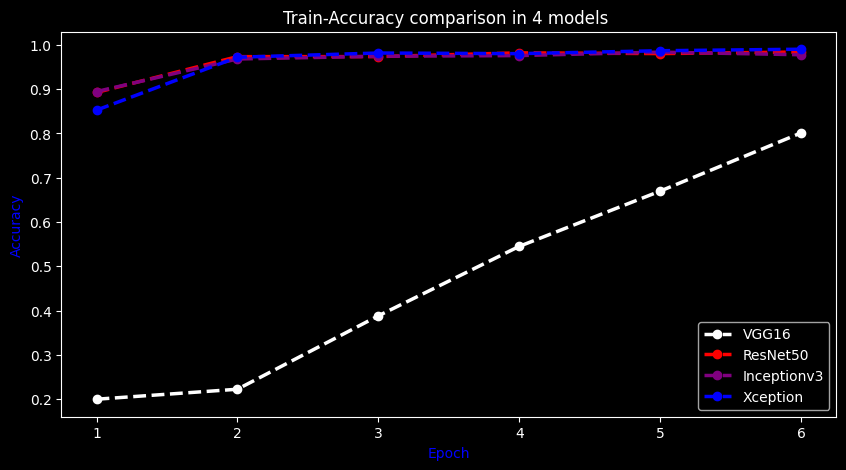

In [129]:
show_all_models(kind='accuracy' , rang = range(1,7,1) , titl='Train-Accuracy' , yl='Accuracy')

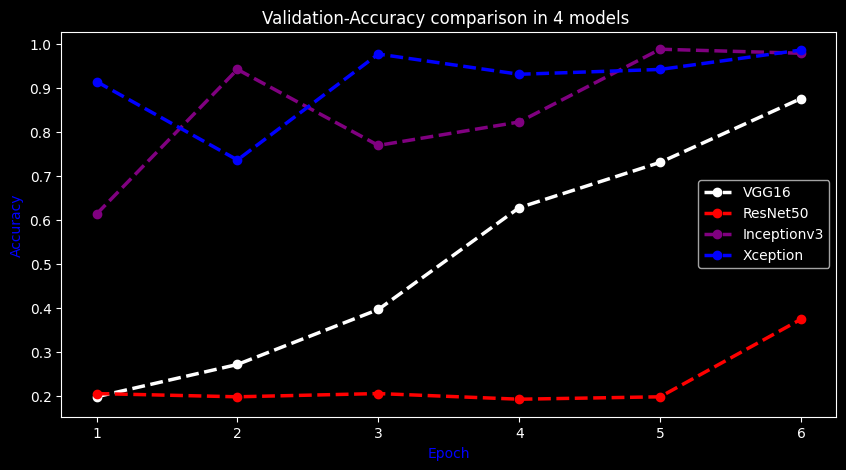

In [133]:
show_all_models(kind='val_accuracy' , rang = range(1,7,1) , titl='Validation-Accuracy' , yl='Accuracy')

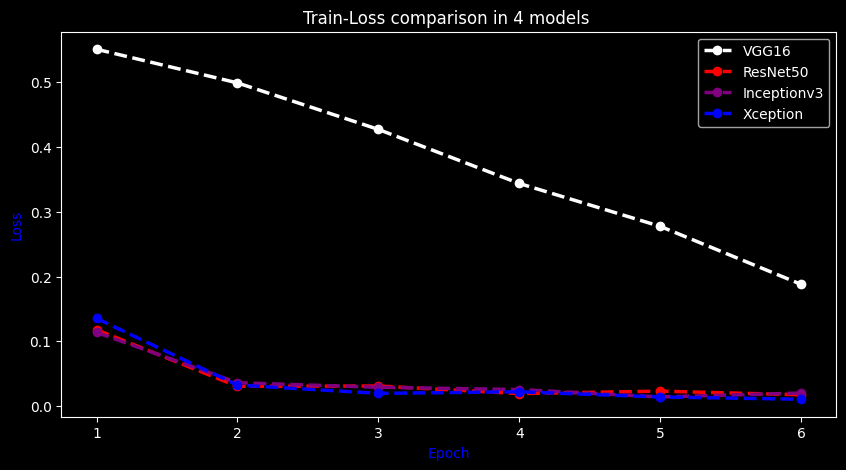

In [134]:
show_all_models(kind='loss' , rang = range(1,7,1) , titl='Train-Loss' , yl='Loss')

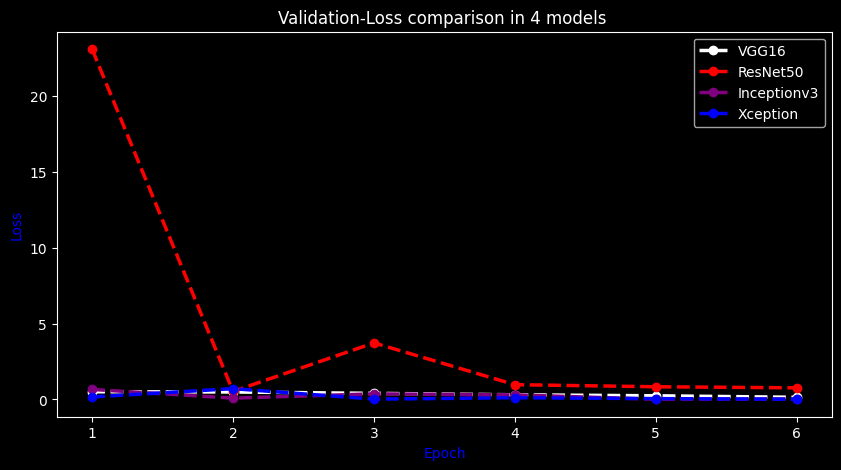

In [136]:
show_all_models(kind='val_loss' , rang = range(1,7,1) , titl='Validation-Loss' , yl='Loss')

## **Xception Model Prediction**

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


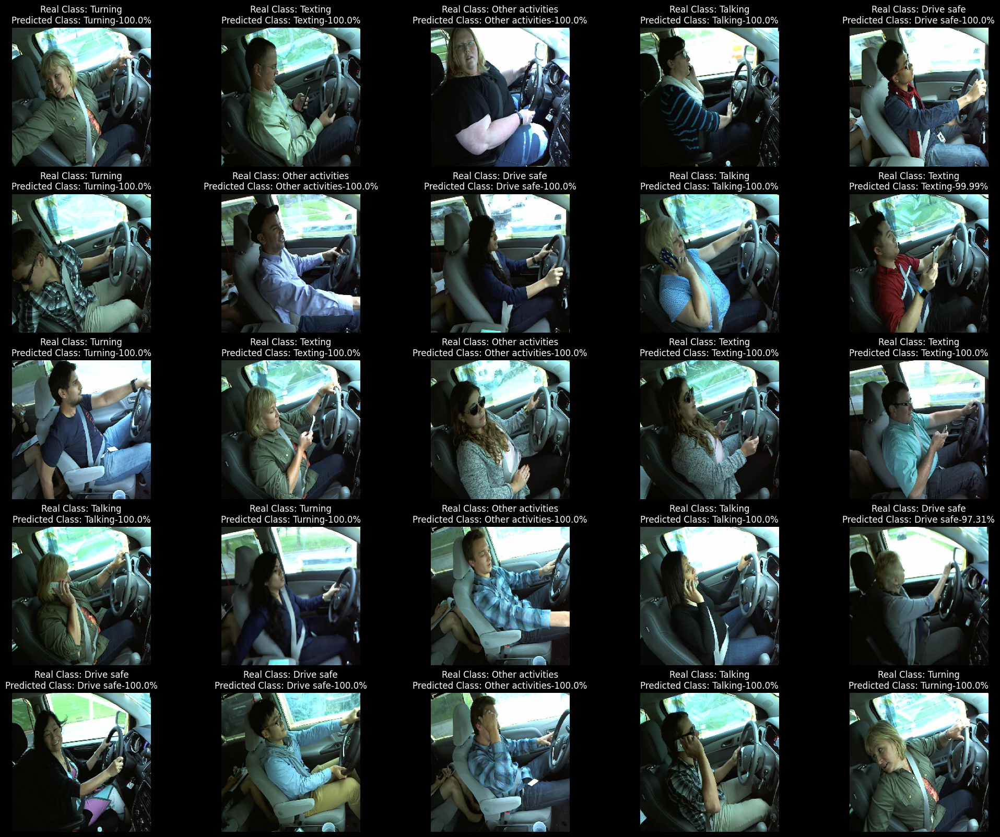

In [139]:
Test_loader.reset()
images, labels = next(Test_loader)
predictions = Model_Xception.predict(images)
predicted_classes = np.argmax(predictions, axis=1)
plt.figure(figsize=(25, 20))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.imshow(images[i])
    plt.axis('off')
    plt.title(f"Real Class: {Driver_behaviour_classes[np.argmax(labels[i])]}\nPredicted Class: {Driver_behaviour_classes[predicted_classes[i]]}-{round(100 * np.max(predictions[i]),2)}%")
    
plt.show()  

## **Models in Dataframe**



**Description :**

**For having all models details I create a dataframe and save all details from history of models in a dataframe.**

In [140]:
CNN_models = ['VGG16' , 'ResNet50' , 'Inceptionv3' , 'Xception']
Models_train_acc = [VGG16_model.history['accuracy'],Res50_model.history['accuracy'],IncV3_model.history['accuracy'],X_model.history['accuracy']]
Models_train_loss = [VGG16_model.history['loss'],Res50_model.history['loss'],IncV3_model.history['loss'],X_model.history['loss']]
Models_validation_acc = [VGG16_model.history['val_accuracy'],Res50_model.history['val_accuracy'],IncV3_model.history['val_accuracy'], X_model.history['val_accuracy']]
Models_validation_loss = [VGG16_model.history['val_loss'],Res50_model.history['val_loss'],IncV3_model.history['val_loss'], X_model.history['val_loss']]

In [141]:
Compare_models = pd.DataFrame({'CNN Model':CNN_models,
            'Train accuracy':Models_train_acc , 
            'Train loss': Models_train_loss  , 
            'Validation accuracy' :Models_validation_acc ,
            'Validation loss' :Models_validation_loss ,
             })

In [142]:
Compare_models

,CNN Model,Train accuracy,Train loss,Validation accuracy,Validation loss
0,VGG16,"[0.2001970261335373, 0.22274518013000488, 0.38...","[0.5509952306747437, 0.49903103709220886, 0.42...","[0.19705340266227722, 0.2707182466983795, 0.39...","[0.5041465759277344, 0.488844096660614, 0.3991..."
1,ResNet50,"[0.8924036622047424, 0.9731830358505249, 0.973...","[0.11795498430728912, 0.030562061816453934, 0....","[0.20441989600658417, 0.19705340266227722, 0.2...","[23.08655548095703, 0.5283244252204895, 3.7248..."
2,Inceptionv3,"[0.894373893737793, 0.9679290652275085, 0.9740...","[0.11379893869161606, 0.03622877970337868, 0.0...","[0.6132596731185913, 0.9429097771644592, 0.769...","[0.6583709120750427, 0.08310165256261826, 0.36..."
3,Xception,"[0.8524518609046936, 0.9718695282936096, 0.981...","[0.13539206981658936, 0.0325424000620842, 0.01...","[0.9152854681015015, 0.7366482615470886, 0.977...","[0.16069349646568298, 0.7097296714782715, 0.01..."


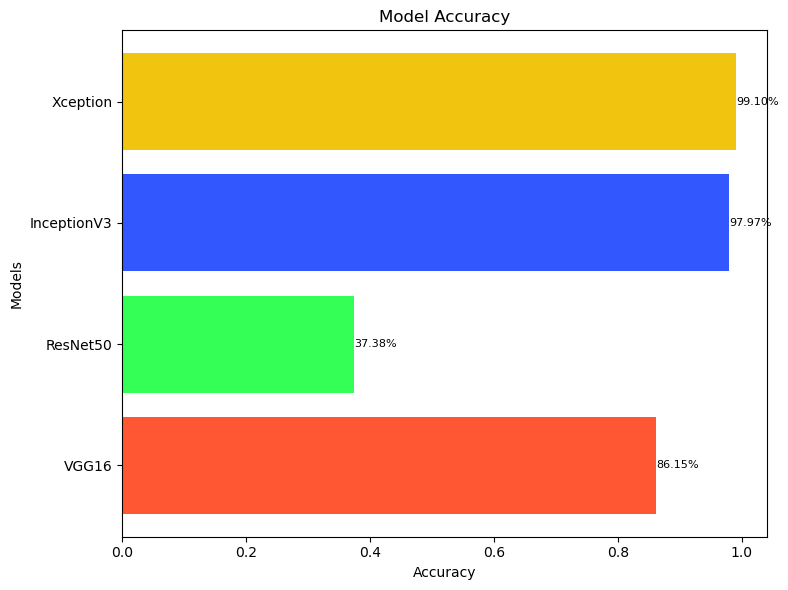

In [6]:
import matplotlib.pyplot as plt

# Example accuracy values (replace with actual computed values)


VGG16accuracy =  0.8615
ResNet50accuracy = 0.3738
Inceptionv3 = 0.9797
Xceptionaccuracy = 0.991


# Model names
x = [ 'VGG16','ResNet50', 'InceptionV3','Xception']

# Accuracy values
y = [VGG16accuracy,ResNet50accuracy, Inceptionv3 , Xceptionaccuracy]

# Define colors for accuracy bars
accuracy_colors = ['#FF5733', '#33FF57', '#3357FF', '#F1C40F', '#8E44AD']

# Create the horizontal bar plot
plt.figure(figsize=(8, 6))
plt.barh(x, y, color=accuracy_colors)
plt.title('Model Accuracy')
plt.ylabel("Models")
plt.xlabel("Accuracy")

# Add accuracy values as text on the bars
for index, value in enumerate(y):
    plt.text(value, index, f"{value * 100:.2f}%", va='center', ha='left', fontsize=8)

plt.tight_layout()
plt.show()
